In [146]:
from google.colab import drive
drive.mount('/content/gdrive')

import numpy as np
XX = np.loadtxt("gdrive/My Drive/colvar.data")

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [147]:
data = XX[:, [2, 3, 51]] #phi, psi, mtd.rbias 

In [148]:
id = [i for i in range(len(XX))]

In [149]:
 # X[index, phi, psi, mtd.rbias]
 X = np.c_[id, data]
 

In [150]:
# modified roulette selection //++ t_weight = np.power(t_weight, 0.0001);

def random_sampling(n_sample, logweight_tensor_, n_landmark):
  t_weight = sum(np.exp(logweight_tensor_))
  print(t_weight)
  t_weight = np.power(t_weight, 0.0001);

  running_t_weight = 0

  landmark_indices = []
  selected = np.full((n_sample), False, dtype=bool)

  n_count = 0

  while(n_count < n_landmark):
    tw = 0
    r01 = np.random.rand()
    r = (t_weight - running_t_weight) * r01

    for j in range(n_sample):
      if(selected[j] == False):
        tw += np.exp(logweight_tensor_[j]);
        if(r < tw):
          selected[j] = True
          landmark_indices.append(j)
          running_t_weight += np.exp(logweight_tensor_[j]);

          break
    n_count += 1

  return landmark_indices


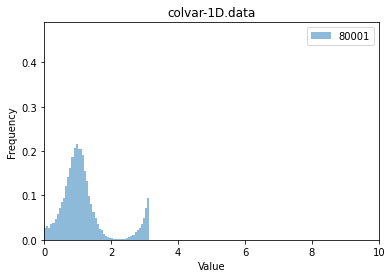

618747.7120219235


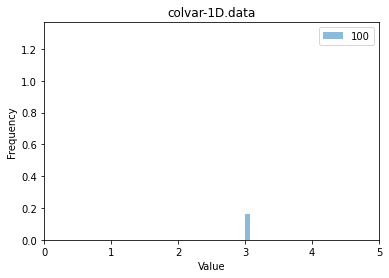

618747.7120219235


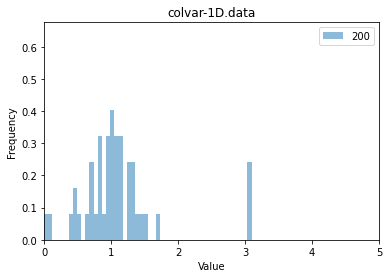

In [151]:
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline

N = len(X)
lw = [row[-1] for row in X] # weights in last column

n_sample = len(X)
logweight_tensor_ = lw

plt.hist(X[:, 1], bins=100, alpha=0.5, density=True, label=N);
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.title('colvar-1D.data')
plt.xlim([0, 10])
plt.legend(loc='upper right')
plt.show();

for k in range(1, 3):
  S = 100 * k
  ndx = random_sampling(n_sample, logweight_tensor_, S)
  ndx.sort();
  numOfColumns = np. size(X, 1)
  A = np.empty(shape=[S, numOfColumns]);
  for i in range(len(ndx)):
    A[i] = (X[ndx[i]]);
  plt.hist(A[:, 1], bins=100, alpha=0.5, density=True, label=S);
  plt.xlabel('Value')
  plt.ylabel('Frequency')
  plt.title('colvar-1D.data')
  plt.xlim([0, 5])
  plt.legend(loc='upper right')
  plt.show();

In [152]:
log_w

array([ -2.163672,  -3.199711,  -1.744235, ..., -14.533692,  -3.953743,
       -18.09623 ])

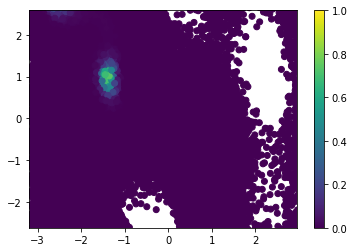

In [153]:
log_w = X[:,-1]
log_w -= np.max(log_w)
w = np.exp(log_w)
fig = plt.figure()
ax = fig.add_subplot('111')
s = ax.scatter(X[:, 1], X[:, 2], c=w)
ax.set_xlim([np.amin(X[1]), np.amax(X[1])])
ax.set_ylim([np.amin(X[2]), np.amax(X[2])])
plt.colorbar(s)

In [154]:
w

array([1.14902424e-01, 4.07739860e-02, 1.74778643e-01, ...,
       4.87638249e-07, 1.91827661e-02, 1.38327067e-08])

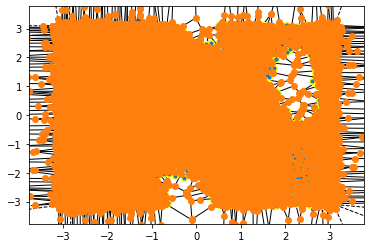

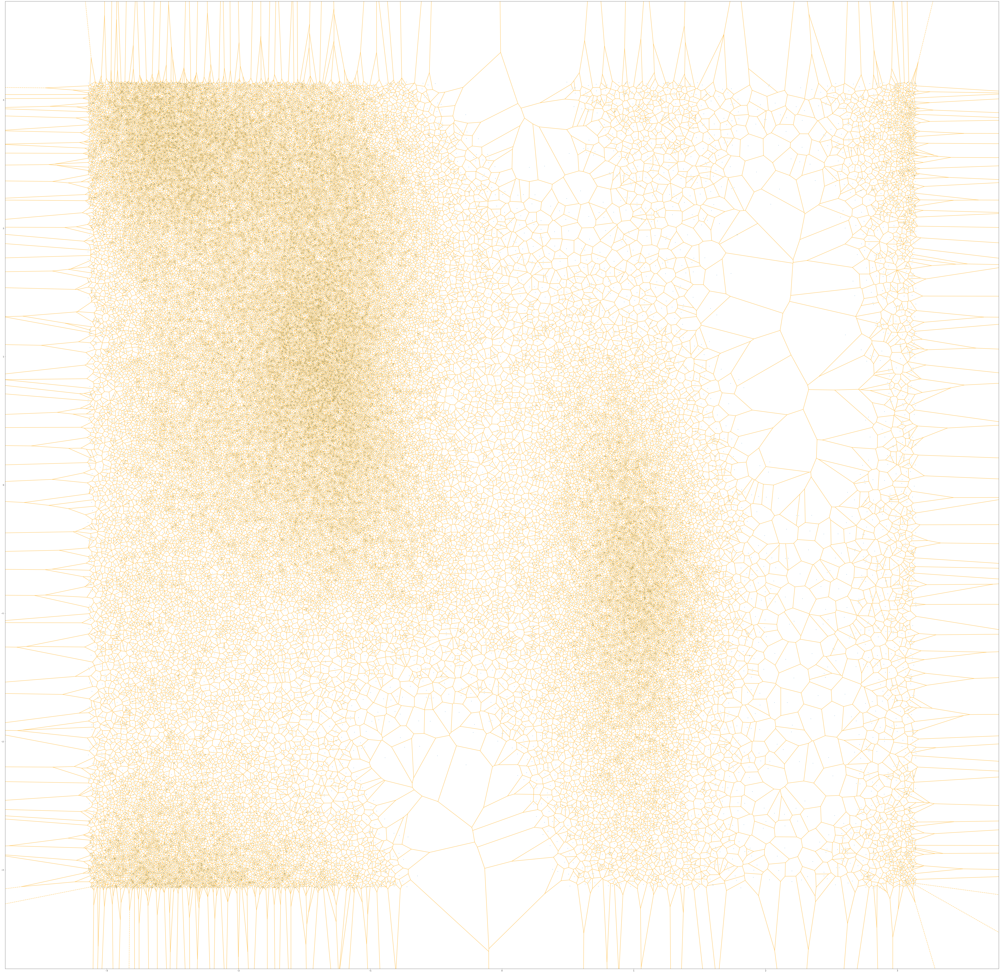

In [155]:
from scipy.spatial import Voronoi, voronoi_plot_2d
vor = Voronoi( X[:, [1,2]])

fig = plt.figure()
ax = fig.add_subplot('111')
ax.plot(X[:, 1], X[:, 2], 'o', color='yellow')
ax.set_xlim([np.amin(X[1]), np.amax(X[1])])
ax.set_ylim([np.amin(X[2]), np.amax(X[2])])
plt.rcParams['figure.figsize'] = (100, 100)
voronoi_plot_2d(vor, ax)
fig = voronoi_plot_2d(vor, show_vertices=False, line_colors='orange', line_width=2, line_alpha=0.6, point_size=2)
plt.show()

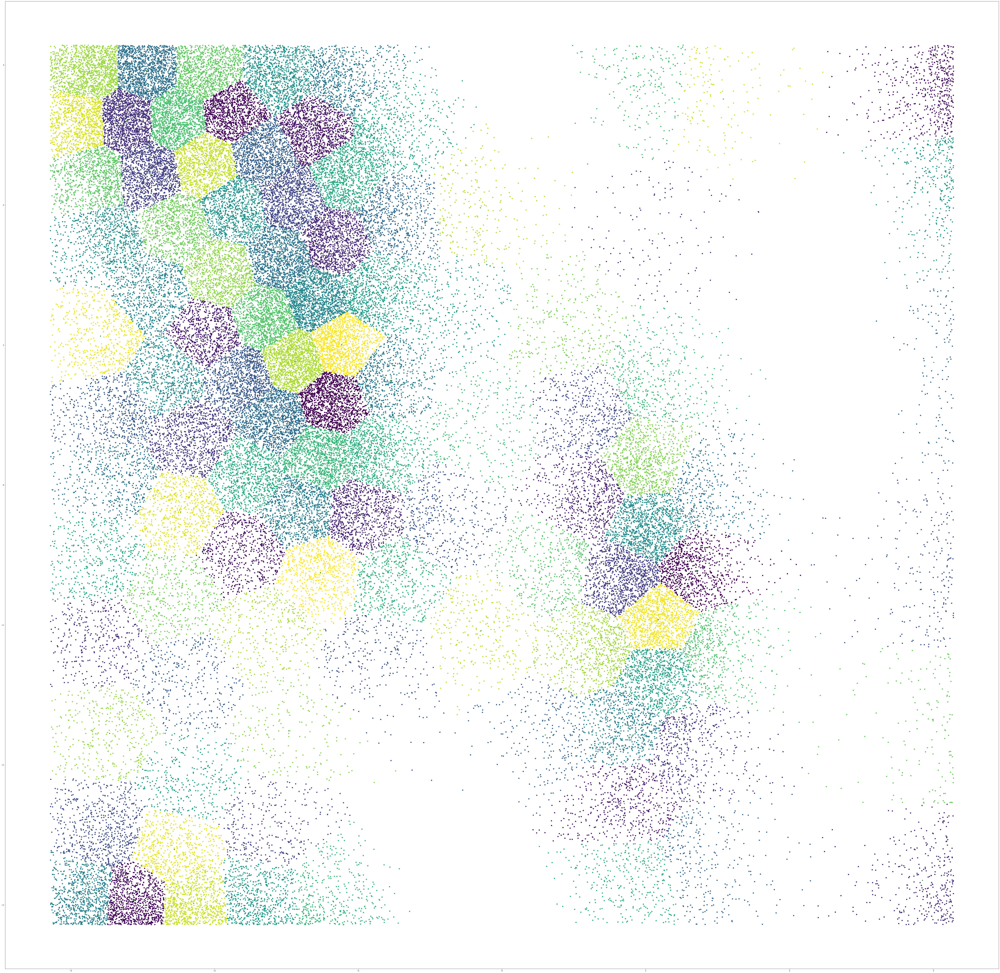

In [156]:
from sklearn.cluster import KMeans

N_clusters=100
km = KMeans(n_clusters=N_clusters)
y_pred = km.fit_predict(X[:,1:3])

new_X = np.c_[X, y_pred]
new_X[:,3] = w #  normalized weights
plt.scatter(new_X[:,1], new_X[:,2], c=new_X[:,4])
plt.scatter(km.cluster_centers_[:,0],km.cluster_centers_[:,1],color='green',marker='*')
plt.show()

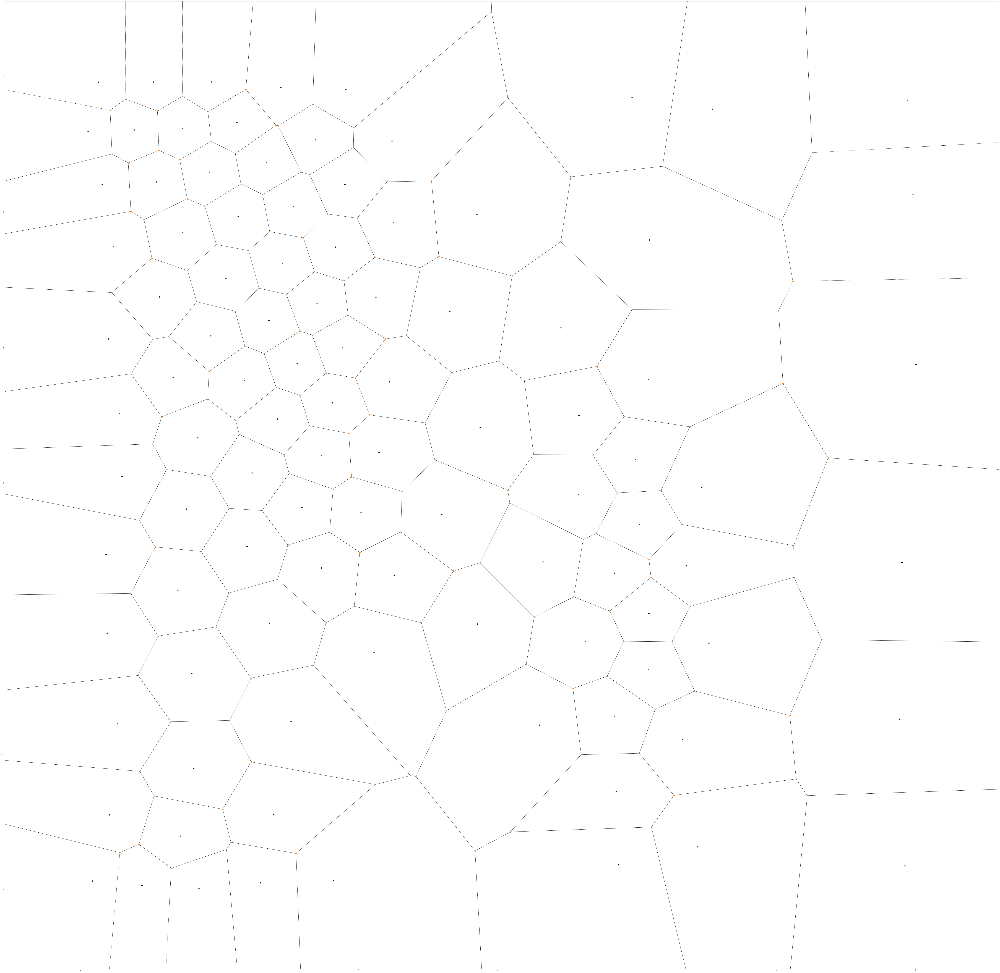

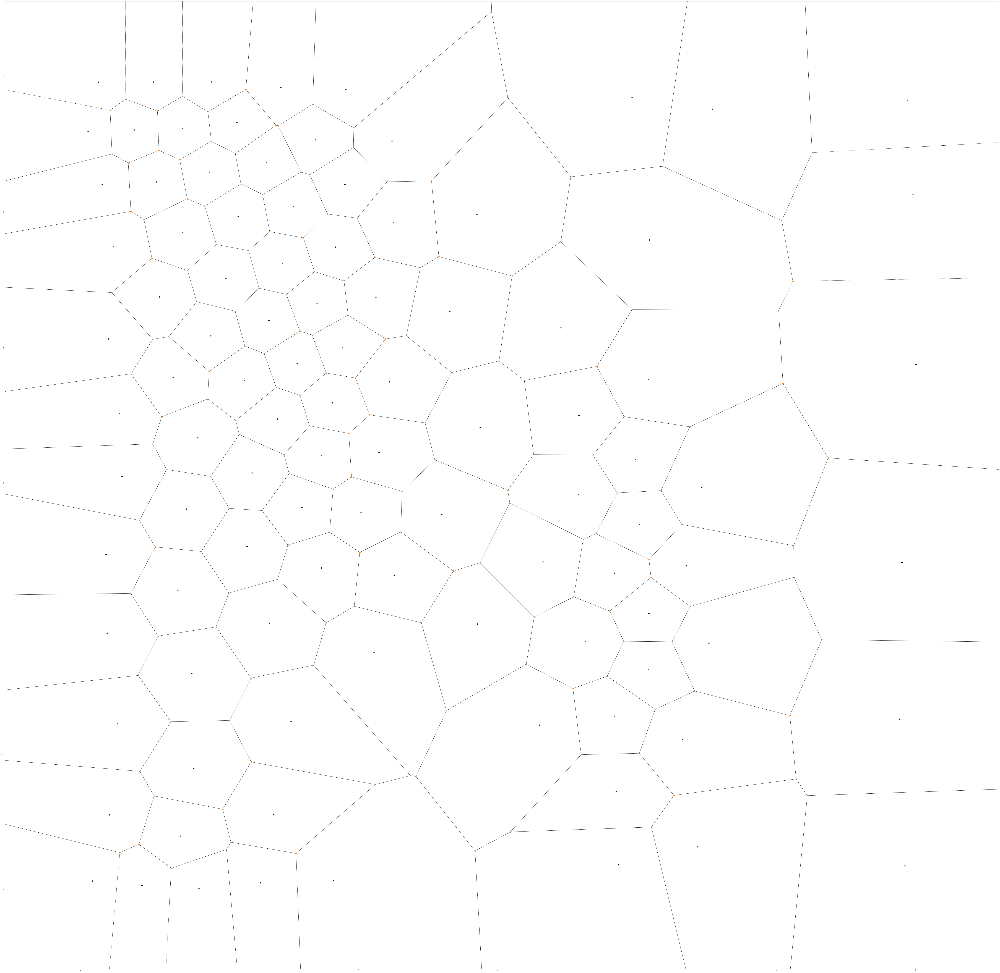

In [157]:
v_cluters = Voronoi(km.cluster_centers_[:,0:2])

fig = plt.figure()
ax = fig.add_subplot('111')
ax.plot(km.cluster_centers_[:, 0], km.cluster_centers_[:, 1], 'o', color='k')
ax.set_xlim([np.amin(new_X[1]), np.amax(new_X[1])])
ax.set_ylim([np.amin(new_X[2]), np.amax(new_X[2])])
voronoi_plot_2d(v_cluters, ax)

In [158]:
sum_of_clust = np.zeros(N_clusters)
for i in range(len(new_X)):
  temp = int(new_X[i,4])
  sum_of_clust[temp] += new_X[i,3]

sum_of_clust

array([1.69986724e+02, 3.22615818e-01, 1.28471940e+01, 4.72437496e+00,
       3.59673412e-04, 2.55136612e-04, 4.17867847e+00, 1.40559576e-06,
       1.29192011e-01, 2.53480980e-03, 8.56878347e-02, 9.63135232e+00,
       6.46577888e-06, 2.05652286e-08, 2.78436183e+02, 9.22266153e-06,
       1.73799150e-02, 9.04041533e-16, 9.04554504e-01, 1.75266425e+01,
       2.88759778e-08, 7.20988462e+00, 1.42903088e-05, 2.34622075e-04,
       1.63155720e-12, 2.31576151e-09, 8.87330102e-07, 6.38825800e+00,
       1.24639333e-04, 1.59720112e-09, 7.86196271e+00, 4.30641503e-09,
       1.56807580e-09, 2.55371767e-13, 7.81126463e-03, 5.14304955e+01,
       2.28303225e+02, 1.00101883e-04, 2.45526235e+01, 3.46640754e-05,
       3.07292112e-02, 4.09283110e-02, 2.18117391e-01, 2.49021262e-04,
       5.80680430e-01, 2.72019411e-03, 3.04615959e+02, 5.19487372e-03,
       6.48984434e-01, 7.29508534e-03, 9.82609055e-01, 1.32868155e+00,
       5.09024434e-06, 2.23746844e-08, 3.18424102e-03, 4.78081002e-01,
      

In [159]:
# modified roulette selection //++ t_weight = np.power(t_weight, 0.0001);

def sample_clusters(n_sample, weights, n_landmark):
  t_weight = sum(weights)
  print(t_weight)
  #t_weight = np.power(t_weight, 0.0001);

  running_t_weight = 0

  landmark_indices = []
  selected = np.full((n_sample), False, dtype=bool)

  n_count = 0

  while(n_count < n_landmark):
    tw = 0
    r01 = np.random.rand()
    r = (t_weight - running_t_weight) * r01

    for j in range(n_sample):
      if(selected[j] == False):
        tw += np.exp(weights[j]);
        if(r < tw):
          selected[j] = True
          landmark_indices.append(j)
          running_t_weight += np.exp(weights[j]);

          break
    n_count += 1

  return landmark_indices


In [160]:
print(sum(w), "\n", w)
print(sum(sum_of_clust), "\n", sum_of_clust)

# picking clasters
N = N_clusters
n_sample = N_clusters

S = 20 
clust_ndx = sample_clusters(n_sample, sum_of_clust, S)
#ndx.sort();


print(clust_ndx)


2465.7736596795025 
 [1.14902424e-01 4.07739860e-02 1.74778643e-01 ... 4.87638249e-07
 1.91827661e-02 1.38327067e-08]
2465.773659679547 
 [1.69986724e+02 3.22615818e-01 1.28471940e+01 4.72437496e+00
 3.59673412e-04 2.55136612e-04 4.17867847e+00 1.40559576e-06
 1.29192011e-01 2.53480980e-03 8.56878347e-02 9.63135232e+00
 6.46577888e-06 2.05652286e-08 2.78436183e+02 9.22266153e-06
 1.73799150e-02 9.04041533e-16 9.04554504e-01 1.75266425e+01
 2.88759778e-08 7.20988462e+00 1.42903088e-05 2.34622075e-04
 1.63155720e-12 2.31576151e-09 8.87330102e-07 6.38825800e+00
 1.24639333e-04 1.59720112e-09 7.86196271e+00 4.30641503e-09
 1.56807580e-09 2.55371767e-13 7.81126463e-03 5.14304955e+01
 2.28303225e+02 1.00101883e-04 2.45526235e+01 3.46640754e-05
 3.07292112e-02 4.09283110e-02 2.18117391e-01 2.49021262e-04
 5.80680430e-01 2.72019411e-03 3.04615959e+02 5.19487372e-03
 6.48984434e-01 7.29508534e-03 9.82609055e-01 1.32868155e+00
 5.09024434e-06 2.23746844e-08 3.18424102e-03 4.78081002e-01
 1.57240

In [168]:
modified_clust_centres = km.cluster_centers_


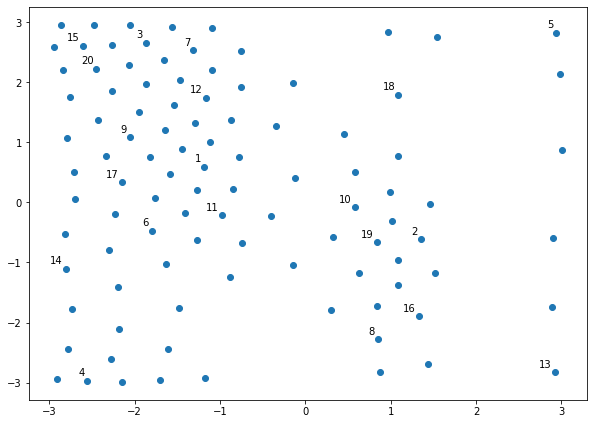

In [167]:
labels = range(1, N_clusters+1) 
plt.figure(figsize=(10, 7))
plt.subplots_adjust(bottom=0.1)
plt.scatter(modified_clust_centres[:,0],modified_clust_centres[:,1], label='True Position')

for label, x, y in zip(labels, modified_clust_centres[0:20, 0], modified_clust_centres[:, 1]):
  plt.annotate(label, xy=(x, y), xytext=(-3, 3), textcoords='offset points', ha='right', va='bottom')
plt.show()

In [163]:
sum(w)

2465.7736596795025

In [164]:
def random_sampling2(n_sample, logweight_tensor_, n_landmark, clust_points):
  t_weight = sum(np.exp(logweight_tensor_))
  print(t_weight)
  # t_weight = np.power(t_weight, 0.0001);

  running_t_weight = 0

  landmark_indices = []
  selected = np.full((n_sample), False, dtype=bool)

  n_count = 0

  while(n_count < n_landmark):
    tw = 0
    r01 = np.random.rand()
    r = (t_weight - running_t_weight) * r01

    for j in range(n_sample):
      if(selected[j] == False):
        tw += np.exp(logweight_tensor_[j]);
        if(r < tw):
          selected[j] = True
          landmark_indices.append(clust_points[j,0])
          running_t_weight += np.exp(logweight_tensor_[j]);

          break
    n_count += 1

  return landmark_indices


In [169]:
selected_points = np.full((len(new_X)), False, dtype=bool)
indexes = []

N = N_clusters
n_sample = N_clusters
S = 20 
clust_ndx = sample_clusters(n_sample, sum_of_clust, S)
print("\npicked clusters: (indexes) ",clust_ndx, "\n")
for i in range(S):
  print("cluster index: ", clust_ndx[i])
  clust_points = new_X[np.where(new_X[:,4] == clust_ndx[i])]
  print("number of points in this cluster: ", len(clust_points))

  n_sample = len(clust_points)
  print("n_sample: ",n_sample)
  logweight_tensor_ = clust_points[:,2].tolist()
  print(type(logweight_tensor_))
  print("logweight_tensor_: ",logweight_tensor_)
  S = 100
  ndx = random_sampling2(n_sample, logweight_tensor_, S, clust_points)
  indexes.extend(ndx)
  print("ndx (picked points from this cluster): ", ndx)
  print(len(ndx), "\n")


print("\nall sampled points: ", indexes)
print("number of points: ",len(indexes))
indexes.sort()
print("\nall sampled points sorted", indexes)


2465.773659679547

picked clusters: (indexes)  [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19] 

cluster index:  0
number of points in this cluster:  1572
n_sample:  1572
<class 'list'>
logweight_tensor_:  [0.715508, 0.617326, 0.554302, 0.485477, 0.448572, 0.635466, 0.717668, 0.633665, 0.40923, 0.664604, 0.4657, 0.65056, 0.489592, 0.684302, 0.469542, 0.643286, 0.637608, 0.549763, 0.555229, 0.564384, 0.527702, 0.404862, 0.601194, 0.713499, 0.622191, 0.551015, 0.731774, 0.533083, 0.559212, 0.780623, 0.409683, 0.535971, 0.776101, 0.55787, 0.570791, 0.718024, 0.627739, 0.640871, 0.483358, 0.601237, 0.545513, 0.507273, 0.791756, 0.723427, 0.507327, 0.507035, 0.592847, 0.479956, 0.456141, 0.50547, 0.620628, 0.594646, 0.705601, 0.730603, 0.576062, 0.570384, 0.42205, 0.504956, 0.443901, 0.580677, 0.803697, 0.488168, 0.489574, 0.57213, 0.681989, 0.679343, 0.707828, 0.686217, 0.71817, 0.54552, 0.53524, 0.517272, 0.412261, 0.56677, 0.738799, 0.736036, 0.496049, 0.696404, 0.